# Explore the Spatial Signatures with Python

In [1]:
import pandas
import geopandas
import contextily
from shapely.geometry import box
from xyzservices import providers

ERROR 1: PROJ: proj_create_from_database: Open of /opt/conda/share/proj failed


## Access the data

We can read the main file over the wire with:

In [2]:
%%time
# Please note the file is almost 1GB
# Depending on the connection, it may take a while
ss = geopandas.read_file(
    'https://figshare.com/ndownloader/files/30904861'
)

CPU times: user 20.1 s, sys: 5.82 s, total: 25.9 s
Wall time: 45.4 s


## Explore the signatures

The file contains one row for each polygon in the signatures product. A polygon is a contiguous patch of land labelled under the same spatial signature.

In [3]:
ss.head()

,id,code,type,geometry
0,0_COA,COA,Countryside agriculture,"POLYGON ((62220.000 798500.000, 62110.000 7985..."
1,1_COA,COA,Countryside agriculture,"POLYGON ((63507.682 796515.169, 63471.097 7965..."
2,2_COA,COA,Countryside agriculture,"POLYGON ((65953.174 802246.172, 65950.620 8022..."
3,3_COA,COA,Countryside agriculture,"POLYGON ((67297.740 803435.800, 67220.289 8034..."
4,4_COA,COA,Countryside agriculture,"POLYGON ((75760.000 852670.000, 75700.000 8527..."


We find a unique ID for each polygon (`id`), the signature (`type`) and its code (`code`), and the geometry of the polygon (`geometry`).

We can plot the map to get a general overview (NOTE: this may take a bit of time depending on your machine):

CPU times: user 37.9 s, sys: 111 ms, total: 38 s
Wall time: 38.9 s


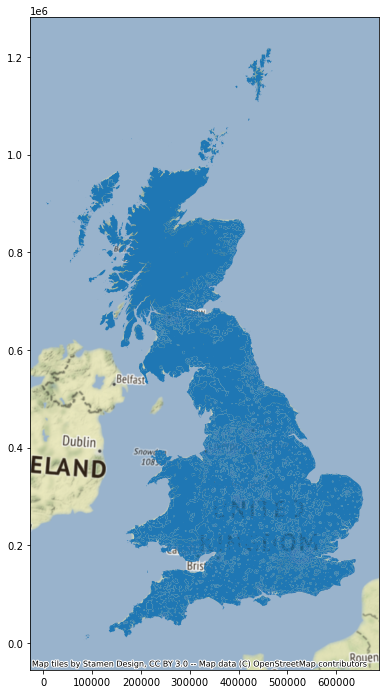

In [4]:
%%time
ax = ss.plot(figsize=(12, 12))
contextily.add_basemap(ax, crs=ss.crs)

## Query sections

The file in full is large and a bit cumbersome to work with, unless you have a powerful system to manipulate it. More normally, however, you will want to access only parts of the entire dataset. Because it is read as a `GeoDataFrame`, this is possible and relatively straight forward.

### Single signature type

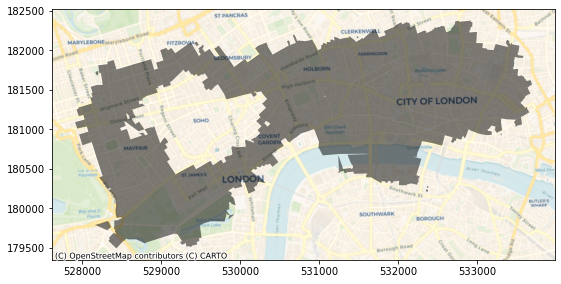

In [5]:
ax = ss.query(
    'type == "Concentrated urbanity"'
).plot(
    color='k', alpha=0.5, figsize=(9, 9)
)
contextily.add_basemap(
    ax, 
    crs=ss.crs,
    source=providers.CartoDB.Voyager,
    zoom=14
)

### Geographic section

Let's focus on Liverpool:

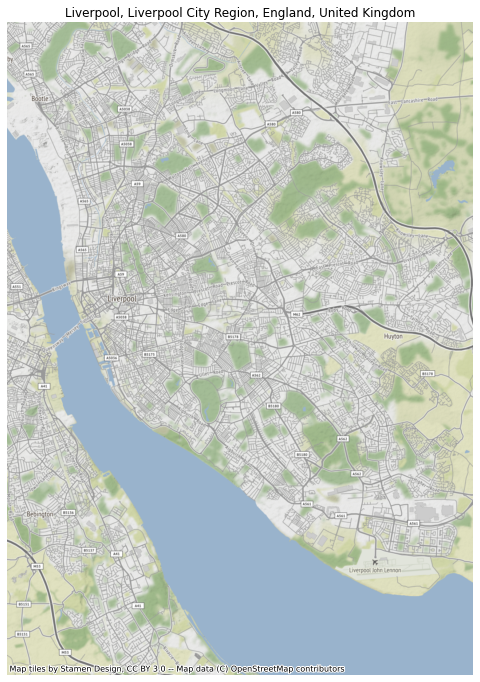

In [6]:
liv = contextily.Place('Liverpool, UK')
liv.plot();

To make things easier, we can pull out the bounding box and convert it to the British grid:

In [7]:
liv_bb = (
    geopandas.GeoSeries([box(*liv.bbox)])
             .set_crs(epsg=4326)
             .to_crs(ss.crs)
)

Now, we can clip the section of signatures within this bounding box. The easiest is `cx`, which grabs everything intersecting the coordinates passed:

In [8]:
w, s, e, n = liv_bb.total_bounds
liv_ss = ss.cx[e:w, s:n]

If we plot that, we see we are indeed keeping a large part of land:

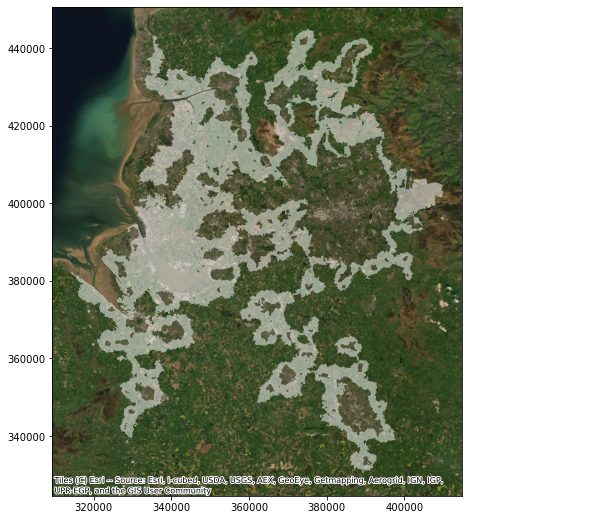

In [9]:
ax = liv_ss.plot(
    color='w',
    alpha=0.5,
    figsize=(9, 9)
)
contextily.add_basemap(
    ax, 
    crs=ss.crs,
    source=providers.Esri.WorldImagery
)

If we just want to clip the extent of interest:

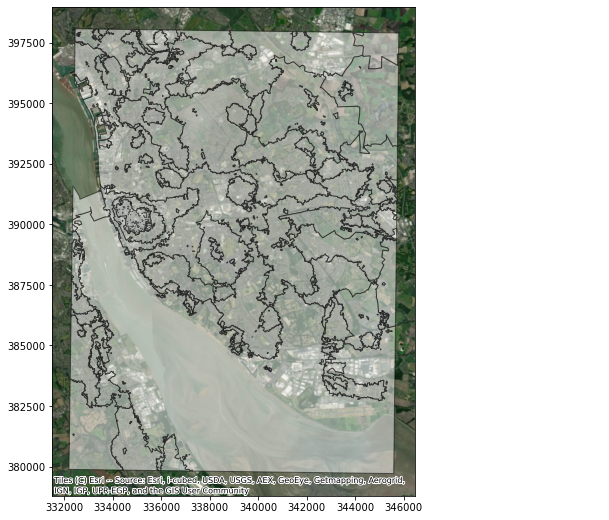

In [10]:
ax = ss.clip(liv_bb).plot(
    facecolor='w',
    edgecolor='k',
    alpha=0.5,
    figsize=(9, 9)
)
contextily.add_basemap(
    ax, 
    crs=ss.crs,
    source=providers.Esri.WorldImagery
)

Or, interactively:

In [11]:
ss.clip(liv_bb).explore()

### Single signature on a geographic section

We can of course also pick only some types within a section of interest:

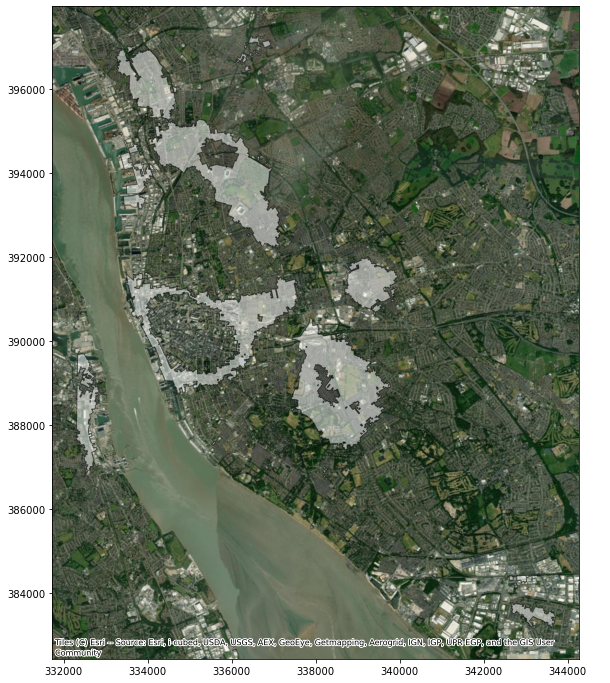

In [12]:
ax = (
    ss
    .clip(liv_bb)
    .query('type == "Dense urban neighbourhoods"')
    .plot(
        facecolor='w',
        edgecolor='k',
        alpha=0.5,
        figsize=(12, 12)
    )
)
contextily.add_basemap(
    ax, 
    crs=ss.crs,
    source=providers.Esri.WorldImagery
)

## Connect signatures to their features

The signatures are defined through an unsupervised method that clusters a large amount of form and function characters defined for very small spatial units (you can read more about the process [here](https://urbangrammarai.xyz/story/#building)). Once these small units are clustered, we dissolve them to delineate the spatial signatures you see in the final data product. To get a better sense of what is behind each polygon, we also provide a table with the average values of each character after aggregation. We will explore those a bit here.


First, we need to access the data, which we can do similarly over the wire:

In [13]:
%%time
# Please note, depending on the connection, this may take a while
chars = pandas.read_csv(
    'https://figshare.com/ndownloader/files/30904903',
    index_col='id'
)

CPU times: user 2.38 s, sys: 669 ms, total: 3.05 s
Wall time: 5.11 s


We have more than 100 characteristics for each signature polygon. For a description of each one, we can access an auxilliary file from the data product:

In [14]:
var_names = pandas.read_csv(
    'https://figshare.com/ndownloader/files/30904888', 
    names=['column_code', 'Full name'], 
    header=0
)
var_names

,column_code,Full name
0,func_population,Population
1,func_night_lights,Night lights
2,func_workplace_abde,"Workplace population [Agriculture, energy and ..."
3,func_workplace_c,Workplace population [Manufacturing]
4,func_workplace_f,Workplace population [Construction]
...,...,...
111,form_lseERI,equivalent rectangular index of enclosure
112,form_lseCWA,compactness-weighted axis of enclosure
113,form_lteOri,orientation of enclosure
114,form_lteWNB,perimeter-weighted neighbours of enclosure


For this illustration, we will use two characters, one relating to form and one to function:

- `func_supermarkets_nearest`
- `form_lcdMes`

From the table above, their full name:

In [15]:
var_names.set_index('column_code').loc[['func_supermarkets_nearest', 'form_lcdMes']]

,Full name
column_code,
func_supermarkets_nearest,Supermarkets [distance to nearest]
form_lcdMes,local meshedness of street network


### Function: distance to nearest supermarket

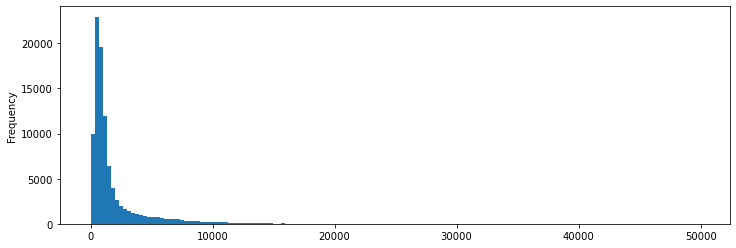

In [16]:
chars['func_supermarkets_nearest'].plot.hist(bins=150, figsize=(12, 4));

*What is the most "supermarket-remote" signature?*

In [17]:
(
    ss
    .join(chars, on='id')
    .query(
        f"func_supermarkets_nearest == {chars['func_supermarkets_nearest'].max()}"
    )
    .explore()
)

### Form: local meshedness

*How is building orientation distributed in Liverpool?*

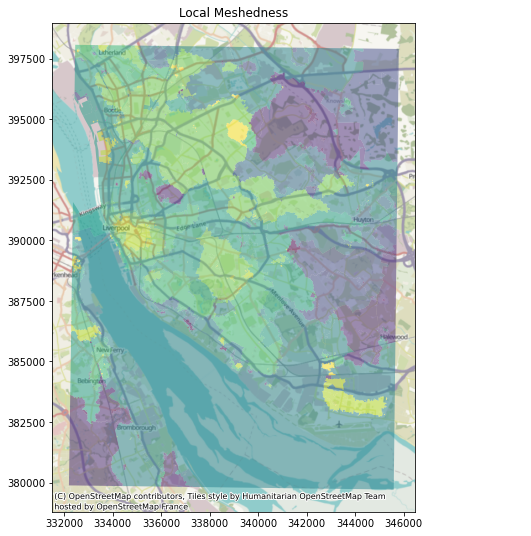

In [18]:
ax = (
    ss
    .clip(liv_bb)
    .join(chars, on='id')
    .plot(
        column='form_lcdMes', 
        scheme='quantiles', 
        k=10,
        alpha=0.5,
        figsize=(9, 9)
    )
)
contextily.add_basemap(
    ax,
    crs=ss.crs,
    source=providers.OpenStreetMap.HOT
)
ax.set_title('Local Meshedness');